This notebook follows on from `006-network_structure_tests.ipynb`. In that notebook the best MSE on the test was `0.024` and the best MAE was `0.107`. In this notebook I want to create some baseline models to compare these to. In that notebook the best scores (for nowcasting only) were for the satellite images alone. Adding the NWP did nothing to improve the scores above sat images alone and the NWP alone were pretty poor in comparison. I want to know whether having bigger rectangles for the NWP might make the predictions better (also control for sat with bigger rectangles).

Also move to GPU to speed up bigger convolutions.

### Index
- [Loading and processing PV](#loading_pv)
- [Choosing NWP channels to load](#nwp_channels)
- [Choosing sat channels to load](#sat_channels)
- [Defining shuffle](#define_shuffle)
- [Defining network factory function](#network_factory)
- [Set up batch loader](#loader)
- __First round of networks__
    - [Create first round of networks](#nets1)
    - [Train first round of networks](#train1)
    - [Evaluate first round of networks](#results1)
- __Second round of networks__
    - [Define second round of networks](#nets2)
- [Compiled results](#compiled_results)
- [Discussion](#discuss)
- [Look at training vs load time](#timings)

In [1]:
import xarray as xr
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

import time
import glob
import json
import os

from sklearn.utils import shuffle 

import src

/opt/conda/lib/python3.7/site-packages/pvlib/solarposition.py:265: UserWarning: Reloading spa to use numba
  warnings.warn('Reloading spa to use numba')


In [2]:
# in case we find any bugs to hot fix
import imp
imp.reload(src.data.batch_loader)

<module 'src.data.batch_loader' from '/home/davidjamesfulton93/repos/predict_pv_yield/src/data/batch_loader.py'>

### Loading and processing PV
<a id='loading_pv'></a>

In [3]:
pv_metadata_df = src.data.load_pv.load_pv_metadata("~/repos/predict_pv_yield/data/"+src.data.load_pv.PV_METADATA_FILEPATH)

In [4]:
pv_metadata_df.head()

,system_name,system_size_watts,postcode,number_of_panels,panel_power_watts,panel_brand,num_inverters,inverter_power_watts,inverter_brand,orientation,...,install_date,latitude,longitude,status_interval_minutes,number_of_panels_secondary,panel_power_watts_secondary,orientation_secondary,array_tilt_degrees_secondary,x,y
system_id,,,,,,,,,,,,,,,,,,,,,
690,3.8kw of Power @ No3,3800,NaN,20,190,Phono Solar,1,4000,SMA Sunny Boy 4000,S,...,2010-12-01 00:00:00,52.087171,-0.263414,10,0,0,NaN,NaN,519080.191006,244623.301288
709,Grove Cottages,2460,RG4,12,205,Romag PowerGlaz SMT6(54)P,1,3000,SMA Sunny Boy 3000TL,SE,...,2010-09-28 00:00:00,51.485329,-0.967526,5,0,0,NaN,NaN,471786.316866,176769.072244
777,Underfell1,3420,NaN,18,190,Schuco MPE 190 MS 05,1,4000,SMA Sunny Boy 4000TL,SW,...,2010-10-29 00:00:00,54.197863,-2.938757,10,0,0,NaN,NaN,338853.840270,478417.935178
794,Roofline,3700,GU34,20,185,Sharp,1,4000,SMA,SE,...,2011-01-05 00:00:00,51.112485,-1.032715,5,0,0,NaN,NaN,467806.490433,135244.187025
973,number38,4000,WA11,16,250,Sungrid/SG250M6,1,3800,Sunny Boy 3800,SW,...,2011-01-13 00:00:00,53.467927,-2.675806,5,0,0,NaN,NaN,355234.617987,397009.685712


In [5]:
pv_power_df = src.data.load_pv.load_pv_power(filepath="~/repos/predict_pv_yield/data/"+src.data.load_pv.PV_DATA_FILEPATH, 
                                             start='2018-01-01', end='2019-12-31')

In [6]:
pv_power_df = pv_power_df.dropna(axis=0, how='all')

In [7]:
pv_power_df.head()

,690,709,794,973,1364,1556,1627,1646,1647,1872,...,68000,68212,68218,68219,68303,68324,68404,68443,68800,68846
datetime,,,,,,,,,,,,,,,,,,,,,
2018-01-01 03:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:35:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:45:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:50:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
# Drop systems (in-place) without PV data and metadata
src.features.preprocessing.filter_to_power_metadata_match(pv_metadata_df, pv_power_df)

In [9]:
# make clearsky GHI object
latitude, longitude = pv_metadata_df.loc[pv_power_df.columns, ['latitude', 'longitude']].values.T
ghiscalar = src.features.transformers.ClearskyScalar(latitude, longitude, g0=10)

# filter data to daylight hours (in-place)
ghiscalar.filter_to_daylight(pv_power_df, min_ghi=20, inplace=True)

In [10]:
# drop systems with no daylight
pv_power_df = pv_power_df.dropna(axis=0, how='all')
src.features.preprocessing.filter_to_power_metadata_match(pv_metadata_df, pv_power_df)

In [11]:
# scale by max power output
rminmax = src.features.transformers.RobustMinMaxScaler(saturation_fraction=0.01)
pv_prop_max_df = rminmax.fit_transform(pv_power_df)

For the satellite and NWP data we will set the loaders to take more than we want. This means we can subset from this for the different networks we train.

### Choosing NWP channels to load
<a id='nwp_channels'></a>

In [12]:
src.data.nwp_loader.AVAILABLE_CHANNELS

,description
channel_name,
t,1.5m air temperature at surface
r,1.5m Relative humidity
dpt,1.5m dew point temperature
vis,1.5m visibility
si10,10m wind speed
wdir10,10m wind direction
prmsl,Mean sea level pressure
unknown_1,Uncertain. This is likely '1.5m fog probability'
unknown_2,Uncertain. This is likely 'snow fraction'


The NWP are hourly and I previously worked out that the average UK wind speed at the typical height of the most common cloud type in the UK is ~43-72km/hour. Lets take the max here and so use a rectangle of 144km in size.

Also take the wind directions so that the network might learn which portion of the forecast is coming towards the PV system. Here we are taking the wind at 10m as a proxy for cloud level wind speeds. The higher level winds speeds are available but aren't yet incorporated into the batch_loader.

In [13]:
nwp_channels = ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf', 'si10', 'wdir10']

In [14]:
# set up NWP loader with some obvious seeming channels (this takes a minute or two)
nwploader = src.data.nwp_loader.NWPLoader(height=144000, width=144000, channels=nwp_channels)

### Choosing sat channels to load
<a id='sat_channels'></a>

In [15]:
pd.set_option('display.max_colwidth', 150)
src.data.sat_loader.AVAILABLE_CHANNELS

,description
channel_name,
VIS006,"λ_central=0.635µm, λ_min=0.56µm, λ_max=0.71µm, | Main observational purposes : Surface, clouds, wind fields"
VIS008,"λ_central=0.81µm, λ_min=0.74µm, λ_max=0.88µm, | Main observational purposes : Surface, clouds, wind fields"
IR_016,"λ_central=1.64µm, λ_min=1.50µm, λ_max=1.78µm, | Main observational purposes : Surface, cloud phase"
IR_039,"λ_central=3.90µm, λ_min=3.48µm, λ_max=4.36µm, | Main observational purposes : Surface, clouds, wind fields"
WV_062,"λ_central=6.25µm, λ_min=5.35µm, λ_max=7.15µm, | Main observational purposes : Water vapor, high level clouds, upper air analysis"
WV_073,"λ_central=7.35µm, λ_min=6.85µm, λ_max=7.85µm, | Main observational purposes : Water vapor, atmospheric instability, upper-level dynamics"
IR_087,"λ_central=8.70µm, λ_min=8.30µm, λ_max=9.1µm, | Main observational purposes : Surface, clouds, atmospheric instability"
IR_097,"λ_central=9.66µm, λ_min=9.38µm, λ_max=9.94µm, | Main observational purposes : Ozone"
IR_108,"λ_central=10.80µm, λ_min=9.80µm, λ_max=11.80µm, | Main observational purposes : Surface, clouds, wind fields, atmospheric instability"


In [16]:
sat_channels = src.data.sat_loader.DEFAULT_CHANNELS
sat_channels

['VIS006',
 'VIS008',
 'IR_016',
 'IR_039',
 'WV_062',
 'WV_073',
 'IR_087',
 'IR_097',
 'IR_108',
 'IR_120',
 'IR_134',
 'HRV']

Take the same sat channels as in the last notebook and take the same image patch as the NWP.

In [17]:
# set up sat loader with high resolutipon visual and a couple of infrared channels
satloader = src.data.sat_loader.SatelliteLoader(height=144000, width=144000, channels=sat_channels)

quick peak at the zarr datasets within the loaders

In [18]:
nwploader.dataset

,Array,Chunk
Bytes,310.72 GB,15.43 MB
Shape,"(5442, 37, 704, 548)","(1, 10, 704, 548)"
Count,92780 Tasks,21768 Chunks
Type,float32,numpy.ndarray


In [19]:
satloader.dataset

,Array,Chunk
Bytes,3.02 TB,18.52 MB
Shape,"(12, 163137, 704, 548)","(12, 1, 704, 548)"
Count,652549 Tasks,163137 Chunks
Type,float32,numpy.ndarray


Set up train and test datasets

### Defining shuffle
<a id='define_shuffle'></a>

In [20]:
# number of time-points to train on and number of systems
n_train_times = int(pv_prop_max_df.shape[0]*0.8)
n_train_systems = int(pv_prop_max_df.shape[1]*0.8)

# shuffle the systems in case they are in significant order
shuffled_columns = shuffle(pv_prop_max_df.columns)
train_columns = shuffled_columns[:n_train_systems]
test_columns = shuffled_columns[n_train_systems:]

# Would be better to train on earlier data and test on later data
# however this is just an example and we only have 2 years data
# therefore we'll shuffle
shuffled_times = shuffle(pv_prop_max_df.index)
train_times = shuffled_times[:n_train_times]
test_times = shuffled_times[n_train_times:]

# train set
y_train = pv_prop_max_df.reindex(index=train_times, columns=train_columns, copy=False)

# test sets
# same systems different times
y_test_time = pv_prop_max_df.reindex(index=test_times, columns=train_columns, copy=False)

# same times different systems
y_test_system = pv_prop_max_df.reindex(index=train_times, columns=test_columns, copy=False)

# different systems and different times
y_test_systemtime = pv_prop_max_df.reindex(index=test_times, columns=test_columns, copy=False)

In [21]:
y_meta_train = pv_metadata_df.reindex(y_train.columns, copy=False)

In [22]:
y_train

,59012,58918,36721,6633,4740,17909,16162,32101,16418,10246,...,67969,27372,6960,19296,58947,29916,8840,6229,68800,27693
datetime,,,,,,,,,,,,,,,,,,,,,
2019-05-16 18:55:00+00:00,0.019337,0.029663,NaN,NaN,0.034360,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.021556,NaN,0.021134,0.022388,NaN,NaN
2018-05-28 05:10:00+00:00,0.059669,0.052011,NaN,0.000931,0.017773,0.05925,0.012748,0.079696,NaN,NaN,...,NaN,NaN,0.014286,0.010943,0.008757,0.046254,0.013449,0.059701,NaN,NaN
2019-07-26 12:55:00+00:00,0.629834,0.642828,NaN,NaN,0.293839,NaN,0.524788,NaN,NaN,NaN,...,0.852459,NaN,NaN,NaN,0.359717,NaN,NaN,0.231343,0.332757,NaN
2019-06-11 19:45:00+00:00,0.000000,0.000000,NaN,NaN,0.000000,NaN,0.001416,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
2019-05-23 05:50:00+00:00,0.081768,0.181633,NaN,0.048107,0.105450,NaN,0.048159,NaN,NaN,NaN,...,NaN,NaN,NaN,0.020202,0.177838,NaN,0.100865,0.082090,NaN,0.126022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-05-26 09:25:00+00:00,0.201105,0.126778,NaN,NaN,0.241706,NaN,0.239377,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.140788,NaN,0.101505,0.455224,NaN,NaN
2018-04-01 07:35:00+00:00,NaN,NaN,NaN,NaN,0.276066,NaN,0.042493,0.045541,NaN,NaN,...,NaN,NaN,0.032143,NaN,NaN,0.122150,0.029139,0.067164,NaN,NaN
2018-06-21 04:45:00+00:00,0.029282,0.011377,NaN,NaN,0.049763,NaN,0.015581,0.047438,NaN,NaN,...,NaN,NaN,0.010714,NaN,0.033681,0.021173,0.018892,0.026119,NaN,NaN


Lets have a quick go at training a neural network

### Defining network factory function
<a id='network_factory'></a>

In [23]:
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import torch

In [24]:
def conv_output_size(H_in, kernel_size, padding, dilation, stride):
    return int((H_in+2*padding - dilation * (kernel_size-1)-1)/stride + 1)

In [25]:
# modification of version from notebook 006. Now with fraction-of-year and lat-lon
class Net(nn.Module):
    def __init__(self, net_sat_channels, 
                 net_nwp_channels, 
                 conv_hidden_units,
                 image_side_length = 11,
                 include_tod=True, 
                 include_toy=False, 
                 include_latlon=False,
                 conv_kernel_size=5, 
                 fc_hidden_units=[1], 
                 conv_batchnorm=False,
                 fc_batchnorm=False,
                 activation=nn.LeakyReLU(),
                 output_activation=F.relu,
                 dropout_frac=0.):
        
        self.config = dict(
                 net_sat_channels=net_sat_channels, 
                 net_nwp_channels=net_nwp_channels, 
                 conv_hidden_units=conv_hidden_units,
                 image_side_length=image_side_length,
                 include_tod=include_tod,
                 include_toy=include_toy,
                 include_latlon=include_latlon,
                 conv_kernel_size=conv_kernel_size, 
                 fc_hidden_units=fc_hidden_units, 
                 conv_batchnorm=conv_batchnorm,
                 fc_batchnorm=fc_batchnorm,
                 activation=str(activation),
                 output_activation=str(output_activation),
                 dropout_frac=dropout_frac
        )
        
        super(Net, self).__init__()
        #nn.Dropout2d ()
        # save channel indexes
        self.sat_indexes = [i for i, channel in enumerate(sat_channels) if channel in net_sat_channels]
        self.nwp_indexes = [i for i, channel in enumerate(nwp_channels) if channel in net_nwp_channels]
        
        self.conv_hidden_units = conv_hidden_units
        self.conv_batchnorm = conv_batchnorm
        
        self.fc_hidden_units = fc_hidden_units
        self.fc_batchnorm = fc_batchnorm
        
        self.dropout_frac = dropout_frac
        self.activation = activation
        self.output_activation = output_activation
        
        self.include_tod = include_tod
        self.include_toy = include_toy
        self.include_latlon = include_latlon

        # set up convolutional layers
        if len(conv_hidden_units)>0:
            self.convs = [nn.Conv2d(in_channels=len(net_sat_channels)+len(net_nwp_channels), 
                                    out_channels=self.conv_hidden_units[0],
                                    kernel_size=conv_kernel_size)]
            self.convs.extend([nn.Conv2d(in_channels=self.conv_hidden_units[i-1], 
                                    out_channels=self.conv_hidden_units[i],
                                    kernel_size=conv_kernel_size)
                         for i in range(1,len(self.conv_hidden_units))])
        
        #  set up convolutional batch-norms
        if conv_batchnorm:
            self.conv_norm = [nn.BatchNorm2d(c) for c in conv_hidden_units]
        
        # keep track of convolutional image size
        self.image_sizes = [image_side_length]
        for i in range(len(conv_hidden_units)):
            self.image_sizes.append(conv_output_size(self.image_sizes[-1], conv_kernel_size, 0, 1, 1))
        
        # set up fully connected layers
        if len(fc_hidden_units)>0:
            # calculate the zeroth number of nodes
            if (len(self.sat_indexes) + len(self.nwp_indexes))>0:
                h0 = self.image_sizes[-1]**2*self.conv_hidden_units[-1]
            else:
                h0 = 0
            h0 += include_tod + include_toy + 2*include_latlon
            self.fc = [nn.Linear(h0, fc_hidden_units[0])] 
            self.fc.extend([nn.Linear(fc_hidden_units[i-1], fc_hidden_units[i]) for i in range(1,len(fc_hidden_units))])
            
        # set up convolutional batch norms
        if fc_batchnorm:
            self.fc_norm = [nn.BatchNorm1d(h) for h in fc_hidden_units]
        
        
        if dropout_frac>0:
            self.dropout = nn.Dropout(p=dropout_frac)
            
        # compile layers
        l = []
        if len(conv_hidden_units)>0: l+=self.convs
        if conv_batchnorm:           l+= self.conv_norm
        if len(fc_hidden_units)>0:   l+=self.fc
        if fc_batchnorm:             l+=self.fc_norm
        
        self.module_list = nn.ModuleList(l)


    def forward(self, batch):
        
        if (len(self.sat_indexes) + len(self.nwp_indexes))>0:
            if len(self.sat_indexes)>0 and len(self.nwp_indexes)>0:
                x = torch.cat((batch['satellite'][:,self.sat_indexes], batch['nwp'][:, self.nwp_indexes]), dim=1)
            elif len(self.sat_indexes)>0:
                x = batch['satellite'][:,self.sat_indexes]
            elif len(self.nwp_indexes)>0:
                x = batch['nwp'][:, self.nwp_indexes]

            for i in range(len(self.convs)):
                x = self.convs[i](x)
                if self.conv_batchnorm:
                    x = self.conv_norm[i](x)
                if self.dropout_frac>0:
                    x = self.dropout(x)
                x = self.activation(x)

            data = [x.view(x.shape[0], -1)]

        else:
            data = []
            
        if self.include_tod: data.append(batch['day_fraction'].view(-1,1))
        if self.include_toy: data.append(batch['year_fraction'].view(-1,1))
        if self.include_latlon: data.append(batch['latlon'].view(-1,2))

        if len(data)>1:
            x = torch.cat(data, dim=1)
        else:
            x = data[0]

        for i in range(len(self.fc)):
            x = self.fc[i](x)
            if i!=len(self.fc)-1:
                if self.conv_batchnorm:
                    x = self.fc_norm[i](x)
                if self.dropout_frac>0:
                    x = self.dropout(x)
                x = self.activation(x)
                
        x = self.output_activation(x)
        
        return x

In [26]:
MSE_LOSS_FUNC = nn.MSELoss()
MAE_LOSS_FUNC = nn.L1Loss()
MODEL_DUMP_ROOT = os.path.expanduser('~/model_dump/007')

class net_container:
    def __init__(self, net, optimizer, loss_func=nn.MSELoss(), run_name=None):
        self.net = net
        self.optimizer = optimizer
        self.loss_func = loss_func
        self.run_name = run_name
        
        self.running_train_loss = 0
        self.running_train_mse = 0
        self.running_train_mae = 0
        
        self.train_losses = []
        self.train_mse_losses = []
        self.train_mae_losses = []
        
        self.test_losses = []
        self.test_mse_losses = []
        self.test_mae_losses = []
        self.batch = []
        self.time_elapsed = []
        
    
    def train_step(self, batch, batch_number):
        
        # zero the parameter gradients
        self.optimizer.zero_grad()

        # forward + backward + optimize
        self.net.train()
        
        outputs = self.net(batch)
        train_loss = self.loss_func(outputs, batch['y'])
        self.running_train_loss += train_loss.item()
        
        train_loss.backward()
        self.optimizer.step()
        
        # MAE
        train_mae = MAE_LOSS_FUNC(outputs, batch['y'])
        self.running_train_mae += train_mae.item()
        
        # MSE
        train_mse = MSE_LOSS_FUNC(outputs, batch['y'])
        self.running_train_mse += train_mse.item()

        # print statistics
        if batch_number == 0 or batch_number % STATS_PERIOD == STATS_PERIOD - 1:    # print every STATS_PERIOD mini-batches

            # Train loss
            if batch_number == 0:
                mean_train_loss = self.running_train_loss
                mean_train_mse = self.running_train_mse
                mean_train_mae = self.running_train_mae
                self.t0 = time.time()
            else:
                mean_train_loss = self.running_train_loss / STATS_PERIOD
                mean_train_mse = self.running_train_mse / STATS_PERIOD
                mean_train_mae = self.running_train_mae / STATS_PERIOD

            self.train_losses.append(mean_train_loss)
            self.train_mse_losses.append(mean_train_mse)
            self.train_mae_losses.append(mean_train_mae)
            
            self.running_train_loss = 0.
            self.running_train_mse = 0.
            self.running_train_mae = 0.

            # Test loss
            self.net.eval()
            test_outputs = self.net(test_batch)
            
            test_loss = self.loss_func(test_outputs, test_batch['y']).item()
            self.test_losses.append(test_loss)
            test_mae = MAE_LOSS_FUNC(test_outputs, test_batch['y']).item()
            self.test_mae_losses.append(test_mae)
            test_mse = MSE_LOSS_FUNC(test_outputs, test_batch['y']).item()
            self.test_mse_losses.append(test_mse)
            
            self.batch.append(batch_number)
            self.time_elapsed.append(time.time() - self.t0)
            
            if self.run_name:
                thisdir = os.path.join(MODEL_DUMP_ROOT, self.run_name)
                if batch_number==0:
                    
                    os.system(f"rm -rf {thisdir}")
                    os.makedirs(os.path.join(thisdir, "figures"))
                    
                    with open(os.path.join(thisdir, 'config.json'), 'w') as f:
                        json.dump(self.net.config, f, indent=4)
                              
                df = pd.DataFrame({
                    'time_elapsed':self.time_elapsed,
                    'batch':self.batch,
                    'train_loss':self.train_losses,
                    'train_mse':self.train_mse_losses,
                    'train_mae':self.train_mae_losses,
                    'test_loss':self.test_losses,
                    'test_mse':self.test_mse_losses,
                    'test_mae':self.test_mae_losses,
                }).to_csv(os.path.join(thisdir, 'training_stats.csv'))
                
                if test_loss == min(self.test_losses):
                    torch.save(self.net, os.path.join(thisdir, 'best_model.pkl'))
                    

### Set up batch loader
<a id='loader'></a>

Need to reduce the number of batches to load in a superbatch due to increasing the size of the sat & NWP rectangles

In [27]:
#import gc
#del batch_generator, test_batch_generator
#gc.collect()
#!free -g

In [28]:
# create training batch generator
batch_generator = src.data.batch_loader.cross_processor_batch(
            y_train, 
            y_meta_train, 
            clearsky=None,
            sat_loader=satloader,
            nwp_loader=nwploader,
            include_tod=True,
            include_toy=True, 
            include_latlon=True,
            lead_time=pd.Timedelta('0 days 00:00:00'),
            batch_size=256,
            batches_per_superbatch=100,
            n_superbatches=None, 
            n_epochs=3, 
            gpu=1,
            consec_samples_per_datetime=50,
            parallel_loading_cores=2)

In [ ]:
# Grab a test batch!
# This may take a minute or two.
test_batch_generator = src.data.batch_loader.cross_processor_batch(
            y_test_systemtime, 
            pv_metadata_df.reindex(y_test_systemtime.columns, copy=False), 
            clearsky=None,
            sat_loader=satloader,
            nwp_loader=nwploader,
            include_tod=True,
            include_toy=True, 
            include_latlon=True,
            lead_time=pd.Timedelta('0 days 00:00:00'),
            batch_size=2000,
            batches_per_superbatch=1, 
            n_superbatches=1, 
            n_epochs=None, 
            gpu=1,
            consec_samples_per_datetime=2,
            parallel_loading_cores=2)

%time test_batch = next(test_batch_generator)

In [ ]:
test_batch = {k:v[...,0] if k!='y' else v for k,v in test_batch.items()}

In [ ]:
!free -g

In [ ]:
torch.cuda.is_available()

In [ ]:
!nvidia-smi

### Create first round of networks
<a id='nets1'></a>

In [ ]:
image_side=72
kernel_size=16
    
def create_climatology_net(fc_hidden_units):
    return Net(
               [],
               [], 
               include_tod=True,
               include_toy=True, 
               include_latlon=True,
               conv_hidden_units=[],
               fc_hidden_units=fc_hidden_units,
               fc_batchnorm=True,
               activation=nn.LeakyReLU(),
               output_activation=F.relu,
               dropout_frac=0.
    ).cuda().half()

def create_satnwp_small_net(sat_channels, nwp_channels):
    return Net(
           sat_channels,
           nwp_channels, 
           include_tod=True,
           include_toy=False, 
           include_latlon=False,
           conv_hidden_units=[10],
           image_side_length=image_side,
           conv_kernel_size=20,
           fc_hidden_units=[20,6,1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
    ).cuda().half()


def create_satnwp_bigger_net(sat_channels, nwp_channels):
    return Net(
           sat_channels,
           nwp_channels, 
           include_tod=True,
           include_toy=False, 
           include_latlon=False,
           conv_hidden_units=[100, 100, 50, 20],
           image_side_length=image_side,
           conv_kernel_size=kernel_size,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
    ).cuda().half()

# baseline climatology models
climatology_base_net = create_climatology_net([20,20,6,1])
climatology_bigger_net = create_climatology_net([50,50,20,10,1])

# baseline HRV only model
hrv_small_net = create_satnwp_small_net(['HRV'],[])
big_nwp_net = create_satnwp_bigger_net([], ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'])

# small sat, nwp and hybrid nets
sat_small_net = create_satnwp_small_net(['IR_016','IR_039','WV_062','IR_087','IR_108','IR_134','HRV'],[])
nwp_small_net = create_satnwp_small_net([], ['t', 'r', 'prmsl', 'lcc', 'mcc', 'hcc', 'dswrf', 'si10', 'wdir10'])
hybrid_small_net = create_satnwp_small_net(
           ['IR_016','IR_039','WV_062','IR_087','IR_108','IR_134','HRV'],
           ['t', 'r', 'prmsl', 'lcc', 'mcc', 'hcc', 'dswrf', 'si10', 'wdir10'], 
)

# bigger sat, nwp and hybrid nets
big_sat_net = create_satnwp_bigger_net(
    ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
    [], 
)
big_hrv_net = create_satnwp_bigger_net(['HRV'], [])
big_hybrid_net = create_satnwp_bigger_net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf', 'si10', 'wdir10'], 
)

In [ ]:
def sgd_training_container(net, name):
    return net_container(
        net,
        optimizer=optim.SGD(net.parameters(), lr=0.01, momentum=0.8), 
        loss_func=nn.MSELoss(),
        run_name=name,
    )

In [ ]:
containers = []
for net, name in [(climatology_base_net, 'climatology_base'),
                  (climatology_bigger_net, 'climatology_bigger'),
                  (hrv_small_net, 'hrv_small'),
                  (big_nwp_net, 'big_nwp'),
                  (sat_small_net, 'sat_small'),
                  (nwp_small_net, 'nwp_small'),
                  (hybrid_small_net, 'hybrid_small'),
                  (big_sat_net, 'big_sat'),
                  (big_hrv_net, 'big_hrv'),
                  (big_hybrid_net, 'big_hybrid'),
                 ]:
    containers.append(sgd_training_container(net, name))

### Train first round of networks
<a id='train1'></a>

In [ ]:
STATS_PERIOD = 100 # batch_generator.batches_per_superbatch

In [ ]:
shuffles_per_superbatch = 4
current_shuffles = 1

for i_batch, batch in enumerate(batch_generator):
    
    batch = {k:v[...,0] if k!='y' else v for k,v in batch.items()}
    for container in containers:
        print(f'batch:{i_batch:03} | {container.run_name:30s}\r', end="")
        container.train_step(batch, i_batch)
        
    # if we have got to end of superbatch reshuffle
    if batch_generator.batch_index==(batch_generator.batches_per_superbatch-1):
        # but only if we haven't already shuffled so mnay times
        if current_shuffles < shuffles_per_superbatch:
            batch_generator.shuffle_cpu_superbatch()
            if batch_generator.gpu==2: batch_generator.transfer_superbatch_to_gpu()
            batch_generator.batch_index = 0
            current_shuffles+=1
        # if we have shiuffled our limit of times then update shuffle tally
        elif current_shuffles >= shuffles_per_superbatch:
            print(f'batch:{i_batch} - reshuffled this super-batch too many times. Loading new.\r', end="")
            current_shuffles = 1


print('\nFinished Training')

### Evaluate first round of networks
<a id='results1'></a>

In [39]:
model_dumps = ['climatology_base','climatology_bigger', 
               'hrv_small', 'sat_small', 'nwp_small', 'hybrid_small',
               'big_hrv', 'big_sat','big_nwp', 'big_hybrid']

dfs = [pd.read_csv(f'~/model_dump/007/{model}/training_stats.csv', )\
                       .drop('Unnamed: 0', axis=1).set_index('batch')\
       for model in model_dumps]

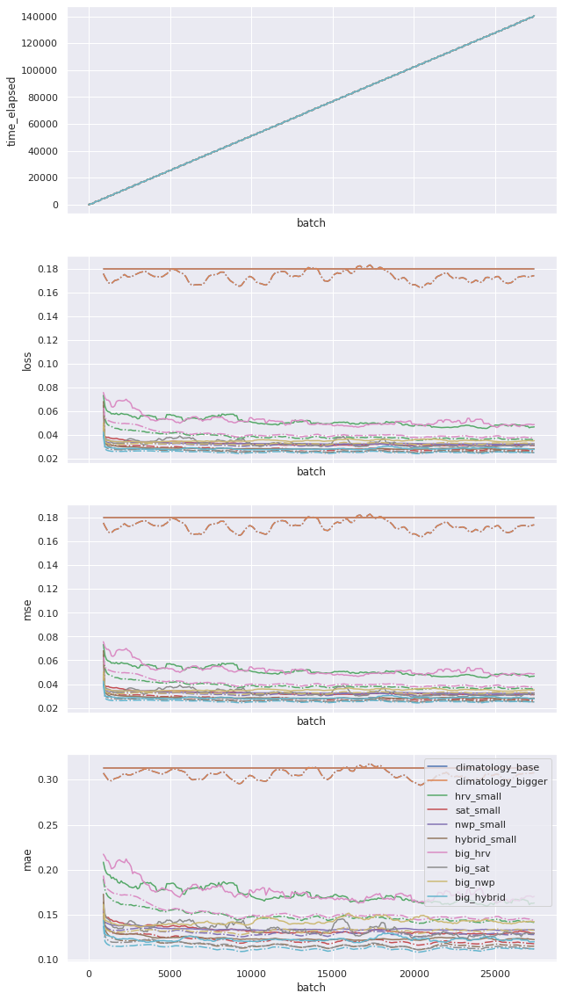

In [62]:
from itertools import cycle
prop_cycle = plt.rcParams['axes.prop_cycle']
sns.set()


fig, axes = plt.subplots(4,1, sharex=True, figsize=(10,20))
axes = axes.flatten()
plot_metrics = ['time_elapsed', 'loss', 'mse', 'mae']

for ax, metric in zip(axes, plot_metrics):
    colors = cycle(prop_cycle.by_key()['color'])
    
    for i in range(len(model_dumps)):
        c = next(colors)
        if metric=='time_elapsed':
            df_ = dfs[i]
        else:
            df_ = dfs[i].rolling(10).mean()
        if metric=='time_elapsed':
            ax.plot(df_.index, df_[metric], label=model_dumps[i], color=c)
        else:
            ax.plot(df_.index, df_['train_'+metric], linestyle='-.', color=c)
            ax.plot(df_.index, df_['test_'+metric], linestyle='-', label=model_dumps[i], color=c)
    ax.set_xlabel('batch')
    ax.set_ylabel(metric)
    #ax.set_yscale('log')
ax.legend()
plt.show()

In [42]:
final_results_df = {}
for i,model in enumerate(model_dumps):
    df = dfs[i].iloc[-100:].mean() # covers last 10000 batches
    for ind in df.index:
        if ind in final_results_df.keys():
            final_results_df[ind].append(df[ind])
        else:
            final_results_df[ind] = [df[ind]] 
pd.DataFrame(final_results_df, index=model_dumps).sort_values('test_loss')

,time_elapsed,train_loss,train_mse,train_mae,test_loss,test_mse,test_mae
hybrid_small,114857.837317,0.026095,0.026095,0.115346,0.028218,0.028218,0.123212
big_hybrid,114861.686996,0.025120,0.025120,0.111713,0.028738,0.028738,0.123320
big_sat,114860.226953,0.025745,0.025745,0.113800,0.030891,0.030891,0.128507
sat_small,114857.515813,0.027402,0.027402,0.119053,0.031287,0.031287,0.129901
nwp_small,114857.548109,0.031226,0.031226,0.128460,0.032455,0.032455,0.133424
big_nwp,114859.971712,0.032718,0.032718,0.132605,0.035292,0.035292,0.143599
hrv_small,114857.104518,0.036636,0.036636,0.143391,0.047764,0.047764,0.165107
big_hrv,114859.661666,0.038473,0.038473,0.146488,0.049736,0.049736,0.169722
climatology_base,114857.270546,0.171556,0.171556,0.303507,0.179932,0.179932,0.313232
climatology_bigger,114857.168005,0.171556,0.171556,0.303507,0.179932,0.179932,0.313232


In [50]:
(([c for c in containers if c.run_name =='climatology_base'][0].net(test_batch)==0)*1.).mean()

tensor(1., device='cuda:0')

The climatology models are predicting zero for every sample. This means training has failed on this occassion. I previous ran this exact same notebook and got climatolgy test MAE of ~0.185. After a lot of batched O(10,000) the network suddenly began to improve and plateaued around this accuracy. So I think take MAE 0.185 as a minimal base model.

HRV alone seems pretty weak in comparison to using more channels. You might notice that the score here for HRV only is lower than achieved in a previous notebook. This is because since then we've started using more robust scaling of the PV output data. We also haven't passed in GHI like we did in a previous notebook.